# Alluvial Diagrams with Plotly

DS 2023 | Communicating with Data

In [22]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

pio.templates.default = "plotly_dark"

## Plotly's Parallel Categories

### Example: Tips

In [23]:
TIPS = px.data.tips()

In [24]:
TIPS.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


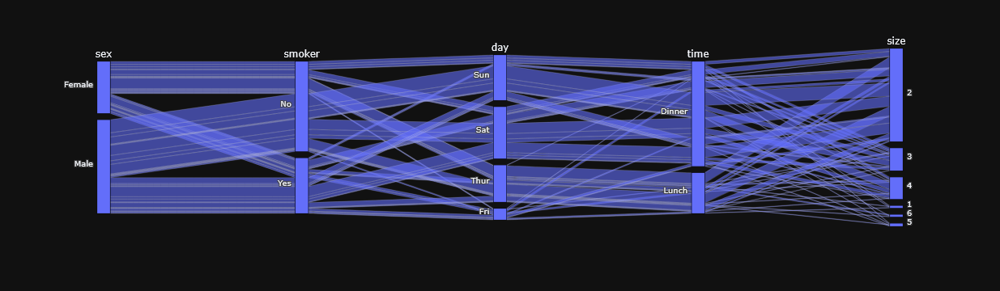

In [25]:
px.parallel_categories(TIPS)

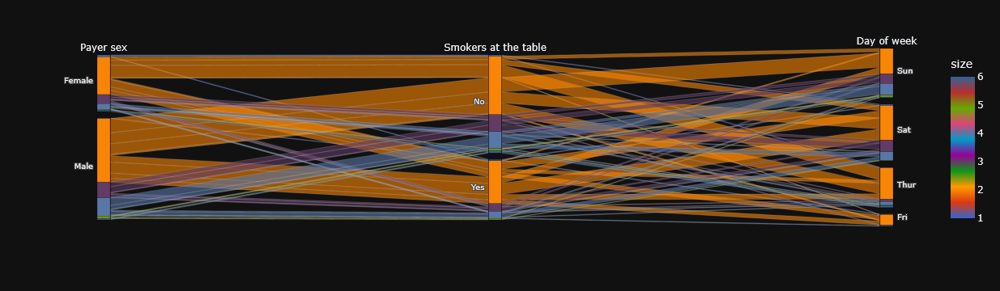

In [26]:
px.parallel_categories(TIPS, 
        dimensions=['sex', 'smoker', 'day'],
        color="size", 
        color_continuous_scale=px.colors.qualitative.G10,
        labels={'sex':'Payer sex', 'smoker':'Smokers at the table', 'day':'Day of week'})

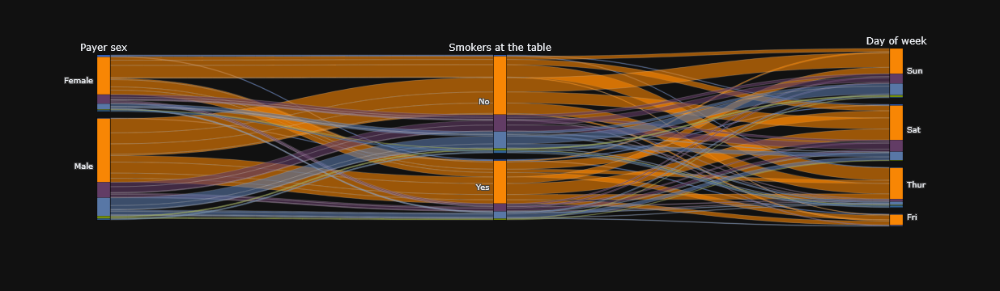

In [27]:
fig = px.parallel_categories(TIPS, 
        dimensions=['sex', 'smoker', 'day'],
        color="size", color_continuous_scale=px.colors.qualitative.G10,
        labels={'sex':'Payer sex', 'smoker':'Smokers at the table', 'day':'Day of week'})
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)
fig.show()

### Wine Reviews (Again :-)

First, let's get the data.

In [29]:
data_file = "./winereviews-DOC_MOD.csv"
DOC = pd.read_csv(data_file)
DOC = DOC.dropna()

And let's visualize only the most frequent values.

In [30]:
COUNTRY = DOC.value_counts('doc_country')
top_countries = COUNTRY[COUNTRY > 1000].index

TASTER = DOC.value_counts('doc_taster')
top_tasters = TASTER[TASTER > 1000].index

VARIETY = DOC.value_counts('doc_variety')
top_varieties = VARIETY[VARIETY > 1000].index

DOC2 = DOC[(DOC.doc_country.isin(top_countries)) & (DOC.doc_taster.isin(top_tasters)) & (DOC.doc_variety.isin(top_varieties))].copy()

In [31]:
DOC2

,doc_id,doc_key,doc_title,doc_country,doc_province,doc_points,doc_price,doc_content,doc_original,doc_variety,doc_taster,doc_place,token_count,doc_sentiment_polarity,doc_sentiment_subjectivity,doc_price_log,doc_points_cat,bbi,bbi_group,doc_points_int
1,1,1,Quinta dos Avidagos 2011 Avidagos Red (Douro)...,Portugal,Douro,87,15.0,"This is ripe and fruity, a wine that is smooth...","This is ripe and fruity, a wine that is smooth...",Portuguese Red,Roger Voss,Portugal Douro,19,0.2,0.46,2.708050,87,5.800000,C,87
2,2,2,Rainstorm 2013 Pinot Gris (Willamette Valley)...,US,Oregon,87,14.0,"Tart and snappy, the flavors of lime flesh and...","Tart and snappy, the flavors of lime flesh and...",Pinot Gris,Paul Gregutt,US Oregon Willamette Valley Willamette Valley,16,0.0,0.36,2.639057,87,6.214286,C,87
4,4,4,Sweet Cheeks 2012 Vintner's Reserve Wild Chil...,US,Oregon,87,65.0,"Much like the regular bottling from 2012, this...","Much like the regular bottling from 2012, this...",Pinot Noir,Paul Gregutt,US Oregon Willamette Valley Willamette Valley,22,0.3,0.45,4.174387,87,1.338462,C,87
9,9,9,Jean-Baptiste Adam 2012 Les Natures Pinot Gri...,France,Alsace,87,27.0,This has great depth of flavor with its fresh ...,This has great depth of flavor with its fresh ...,Pinot Gris,Roger Voss,France Alsace Alsace,14,0.3,0.57,3.295837,87,3.222222,C,87
10,10,10,Kirkland Signature 2011 Mountain Cuvée Cabern...,US,California,87,19.0,"Soft, supple plum envelopes an oaky structure ...","Soft, supple plum envelopes an oaky structure ...",Cabernet Sauvignon,Virginie Boone,US California Napa Valley Napa,22,0.4,0.62,2.944439,87,4.578947,C,87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129960,129960,129960,Caves Transmontanas 2006 Vértice Pinot Noir (...,Portugal,Douro,90,48.0,"Fresh and fruity, this is full of red cherry f...","Fresh and fruity, this is full of red cherry f...",Pinot Noir,Roger Voss,Portugal Douro,19,0.3,0.34,3.871201,90,1.875000,C,90
129965,129965,129965,Domaine Rieflé-Landmann 2013 Seppi Landmann V...,France,Alsace,90,28.0,"While it's rich, this beautiful dry wine also ...","While it's rich, this beautiful dry wine also ...",Pinot Gris,Roger Voss,France Alsace Alsace,22,0.2,0.45,3.332205,90,3.214286,C,90
129966,129966,129966,Dr. H. Thanisch (Erben Müller-Burggraef) 2013...,Germany,Mosel,90,28.0,Notes of honeysuckle and cantaloupe sweeten th...,Notes of honeysuckle and cantaloupe sweeten th...,Riesling,Anna Lee C. Iijima,Germany Mosel,20,0.6,1.00,3.332205,90,3.214286,C,90
129967,129967,129967,Citation 2004 Pinot Noir (Oregon) (Pinot Noi...,US,Oregon,90,75.0,Citation is given as much as a decade of bottl...,Citation is given as much as a decade of bottl...,Pinot Noir,Paul Gregutt,US Oregon Oregon Oregon Other,24,0.0,0.21,4.317488,90,1.200000,C,90


Finally, let's convert our columns to categories.

This will be useful in assigning color to our plots.

In [32]:
DOC2.doc_country = DOC2.doc_country.astype('category')
DOC2.doc_taster = DOC2.doc_taster.astype('category')
DOC2.doc_variety = DOC2.doc_variety.astype('category')
DOC2.doc_points = DOC2.doc_points.astype('category')

#### Country and Taster

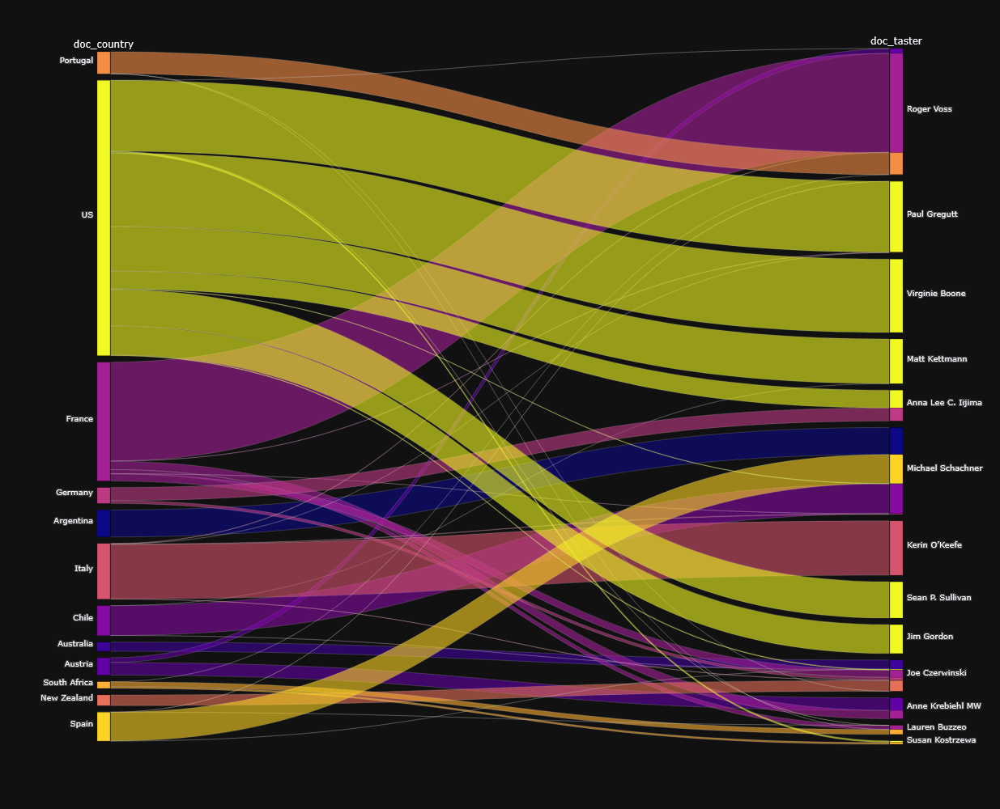

In [33]:
fig = px.parallel_categories(
    DOC2, 
    dimensions=['doc_country', 'doc_taster'], 
    color=DOC2.doc_country.cat.codes, 
    height=1000
)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)

Color by Taster.

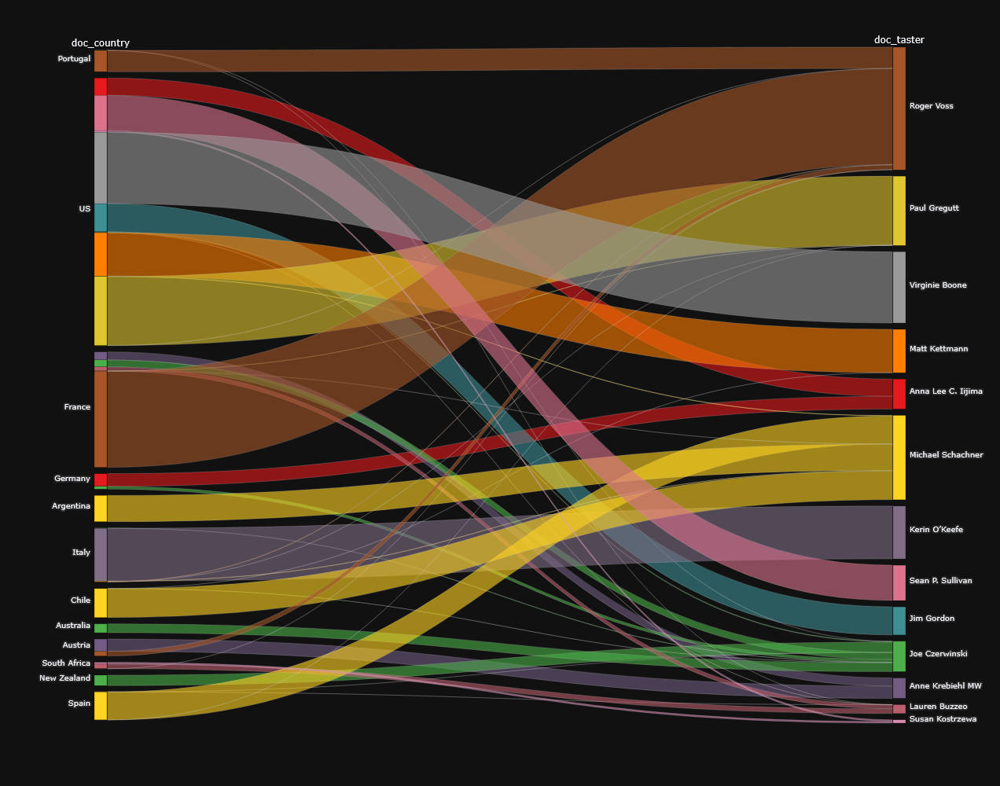

In [34]:
fig = px.parallel_categories(DOC2, dimensions=['doc_country', 'doc_taster'], 
        color=DOC2.doc_taster.cat.codes, 
        color_continuous_scale=px.colors.qualitative.Set1,
        height=1000)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)

#### Country and Variety

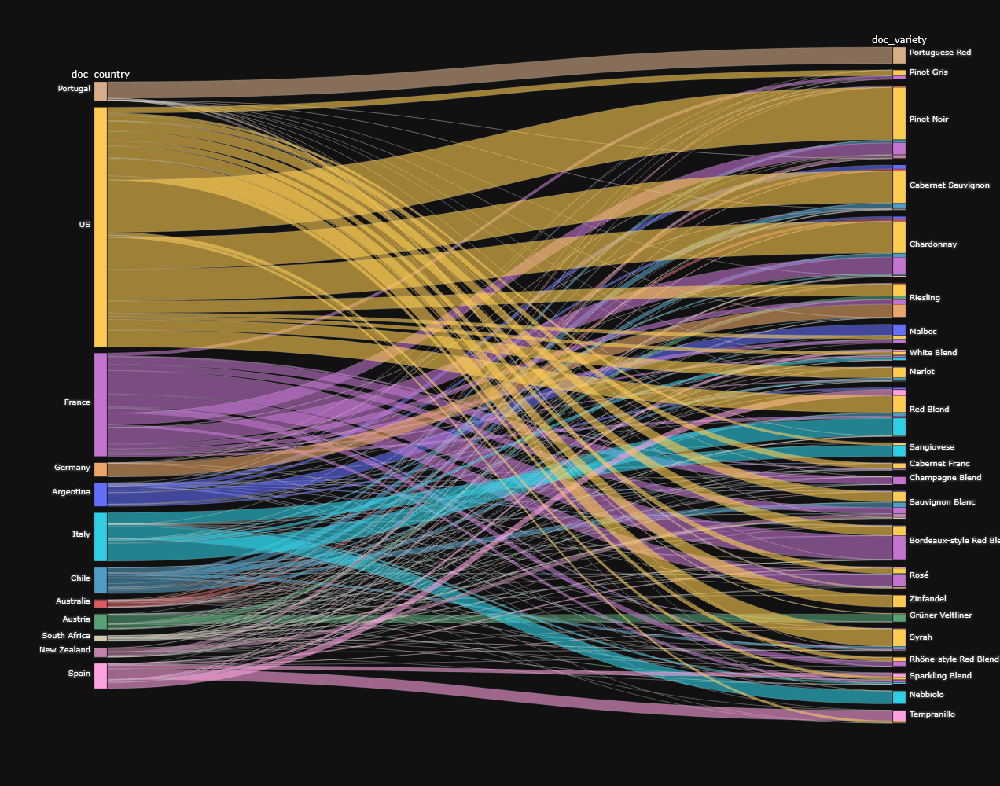

In [35]:
fig = px.parallel_categories(
    DOC2, dimensions=['doc_country', 'doc_variety'], 
    color=DOC2.doc_country.cat.codes, 
    color_continuous_scale=px.colors.qualitative.Plotly,
    height=1000
)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)

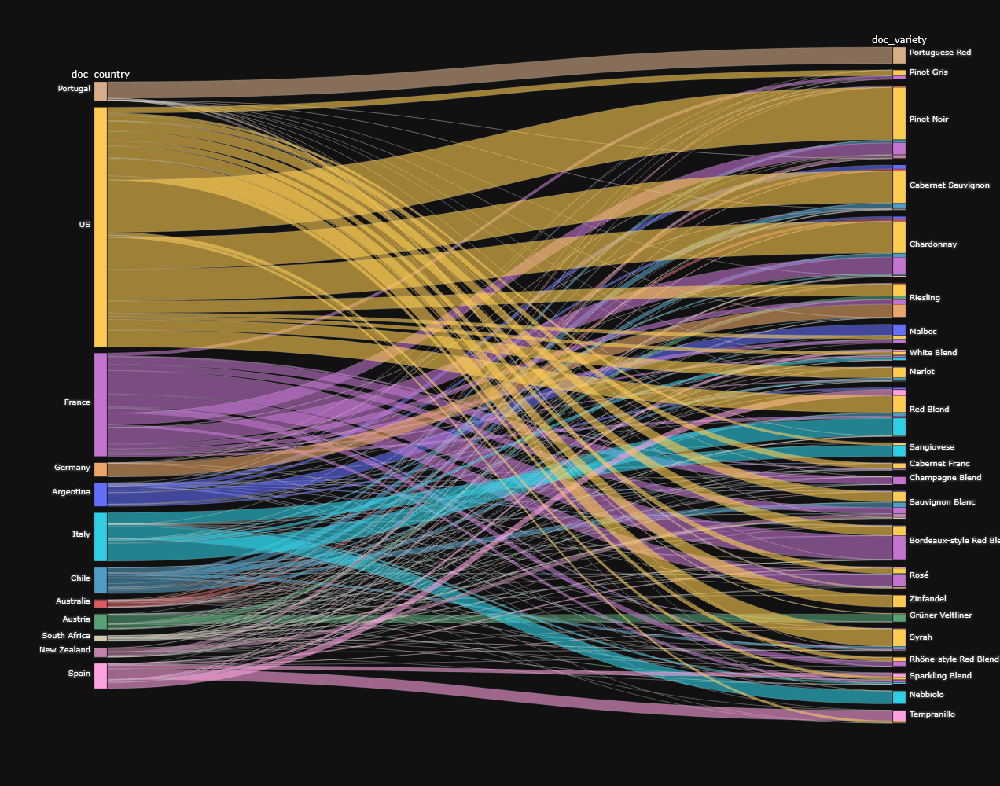

In [36]:
px.parallel_categories(
    DOC2, dimensions=['doc_country', 'doc_variety'], 
    color=DOC2.doc_variety.cat.codes, 
    color_continuous_scale=px.colors.qualitative.Plotly,
    height=1000
)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)

#### Country and Points

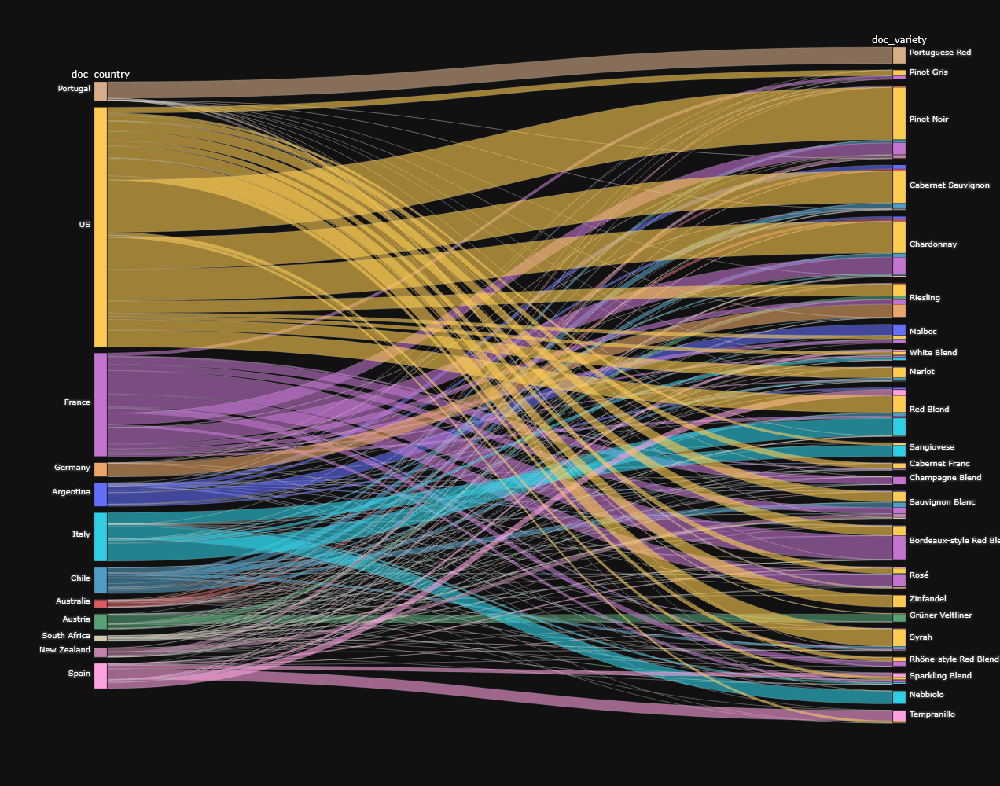

In [37]:
px.parallel_categories(DOC2, dimensions=['doc_country', 'doc_points'], 
        color=DOC2.doc_country.cat.codes, 
        color_continuous_scale=px.colors.qualitative.Set2,                       
        height=1000)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)

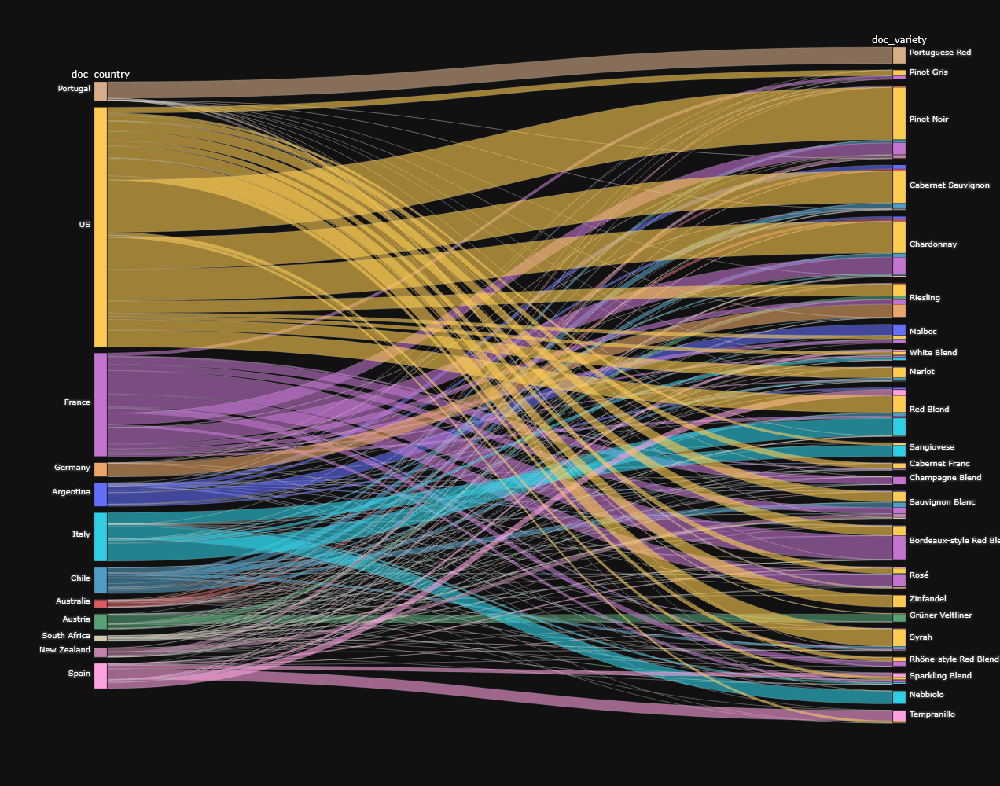

In [38]:
px.parallel_categories(DOC2, dimensions=['doc_country', 'doc_points'], 
        color=DOC2.doc_points.cat.codes, 
        color_continuous_scale=px.colors.qualitative.Set2,                       
        height=1000
)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)

#### Country, Taster, and Points

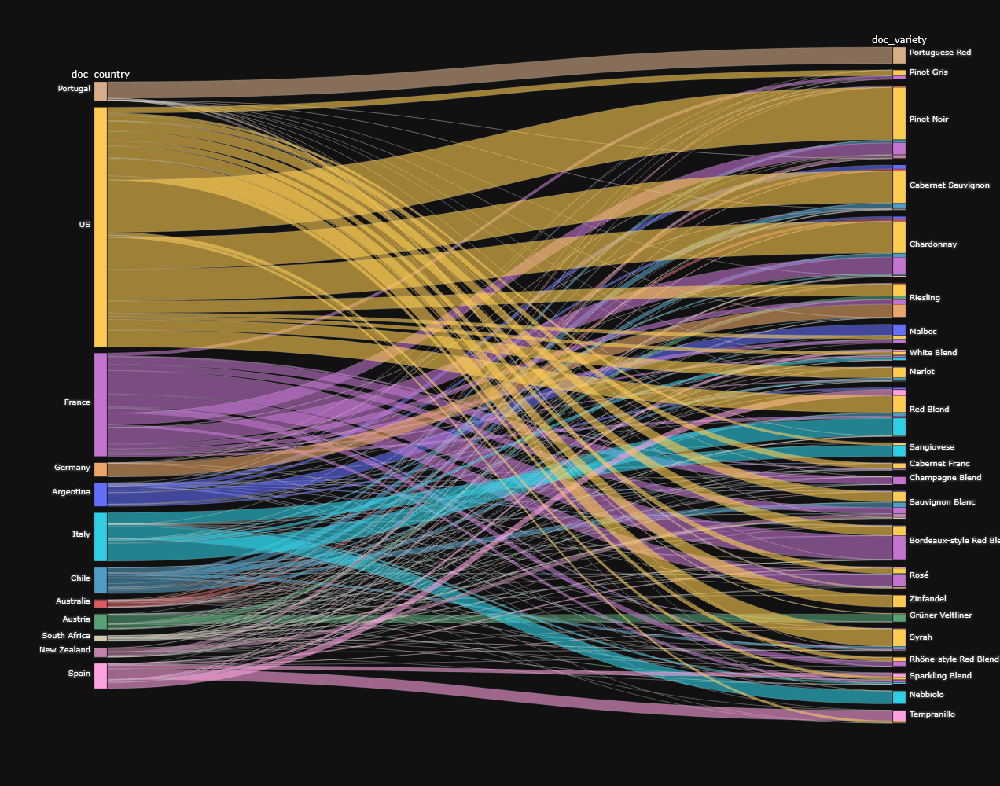

In [39]:
px.parallel_categories(DOC2, 
        dimensions=['doc_country', 'doc_taster', 'doc_points'],
        color=DOC2.doc_taster.cat.codes,
        height=1000
)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)

### Adding Labels

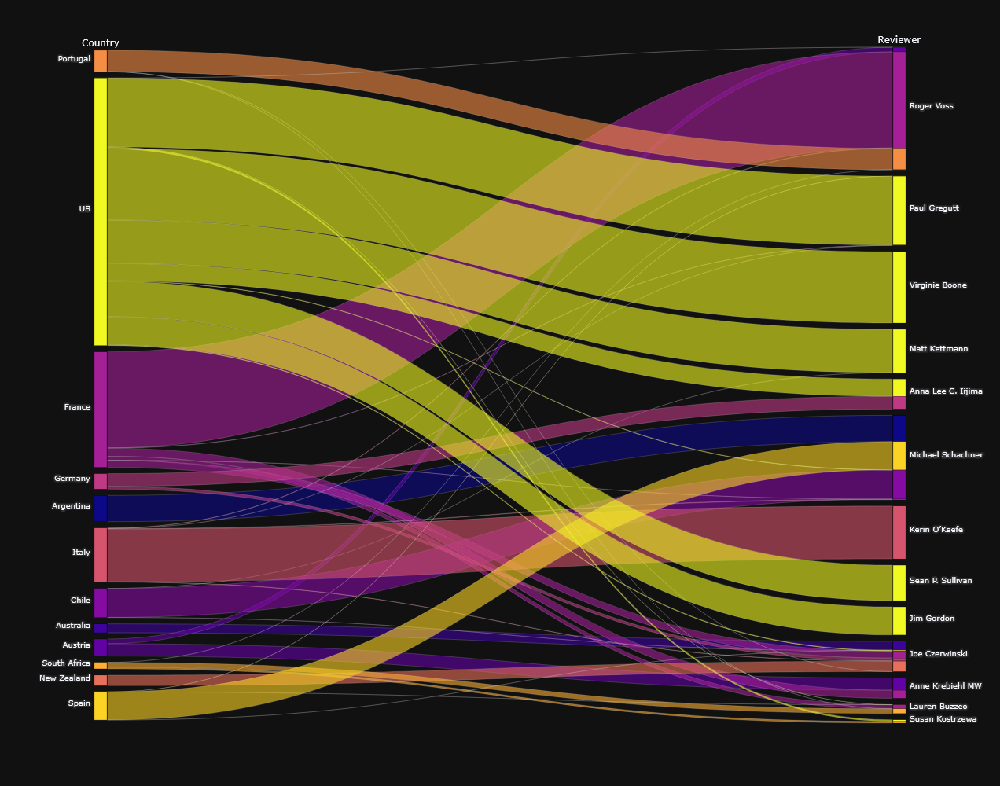

In [40]:
fig = px.parallel_categories(
    DOC2, 
    dimensions=['doc_country', 'doc_taster'], 
    labels={'doc_country':'Country', 'doc_taster':'Reviewer'},
    color=DOC2.doc_country.cat.codes, 
    height=1000,
    title=""
)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)
fig.show()

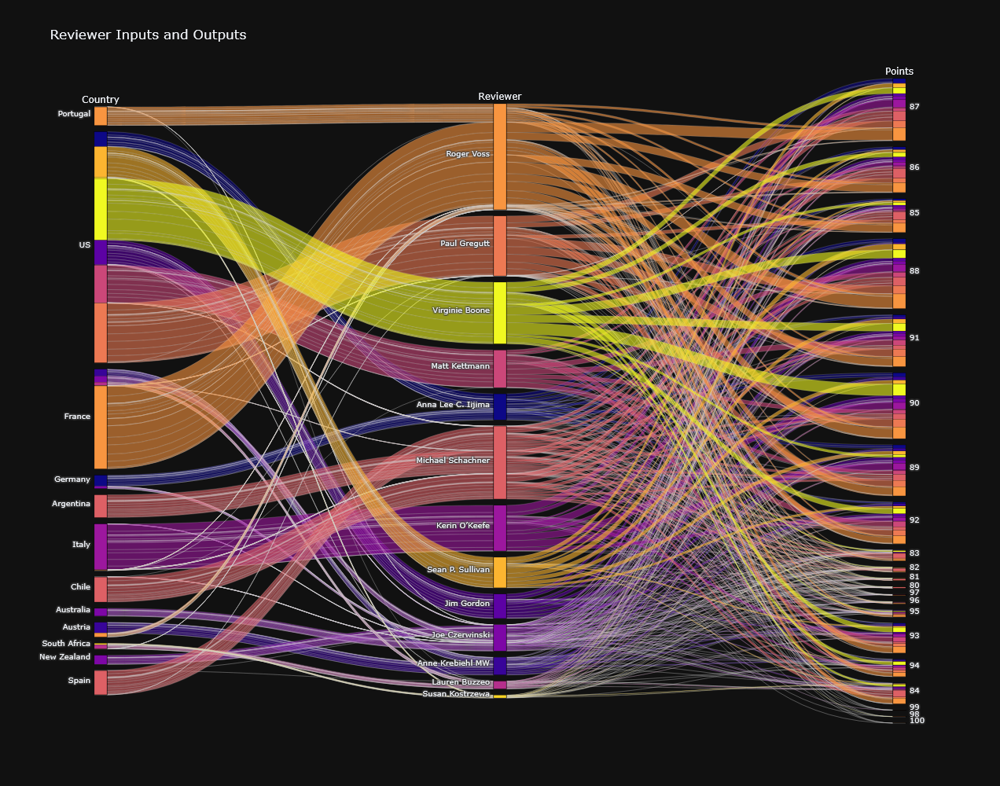

In [41]:
fig = px.parallel_categories(DOC2,  # .sort_values('doc_points', ascending=False)
        dimensions=['doc_country', 'doc_taster', 'doc_points'],
        labels={'doc_country':'Country', 'doc_taster':'Reviewer', 'doc_points':'Points'},
        color=DOC2.doc_taster.cat.codes,
        # color=DOC2.doc_country.cat.codes,
        height=1000,
        title="Reviewer Inputs and Outputs"
)
fig.update_traces(line={'shape': 'hspline'})
fig.update_layout(coloraxis_showscale=False)
fig.show()

## Handy-Dandy Function

In [42]:
def alluvialplot(df, dim_cols_dict:dict, color_col:str, title=None):

    # The color column must be a category
    if df[color_col].dtype != 'category':
        df[color_col] = df[color_col].astype('category')

    fig = px.parallel_categories(df, 
        dimensions=dim_cols_dict.keys(),
        labels=dim_cols_dict,
        color=df[color_col].cat.codes,
        height=1000,
        title=title
    )
    fig.update_traces(line={'shape': 'hspline'})
    fig.update_layout(coloraxis_showscale=False)
    fig.show()

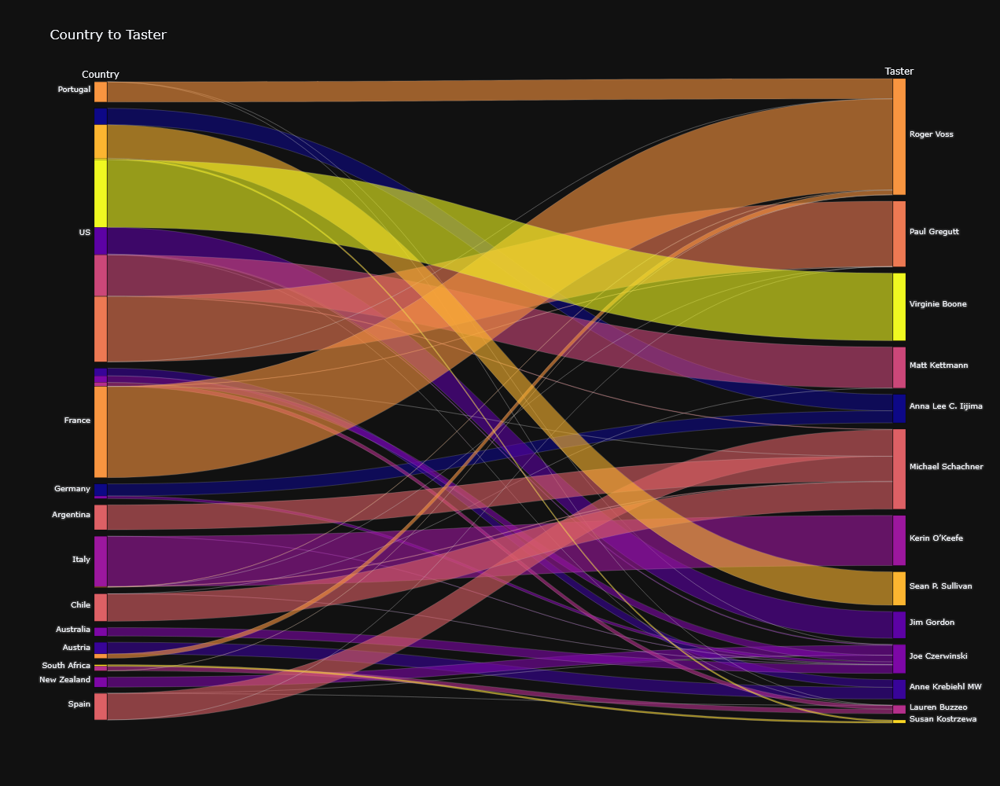

In [43]:
my_cols = {
    'doc_country': 'Country',
    'doc_taster': "Taster",
}
alluvialplot(DOC2, my_cols, 'doc_taster', "Country to Taster")

# Comparison to Heatmaps

**The Good**

Compare this heatmap to the previous alluvial diagram.

The alluvial shows more clearly the dominance of certain tasters.

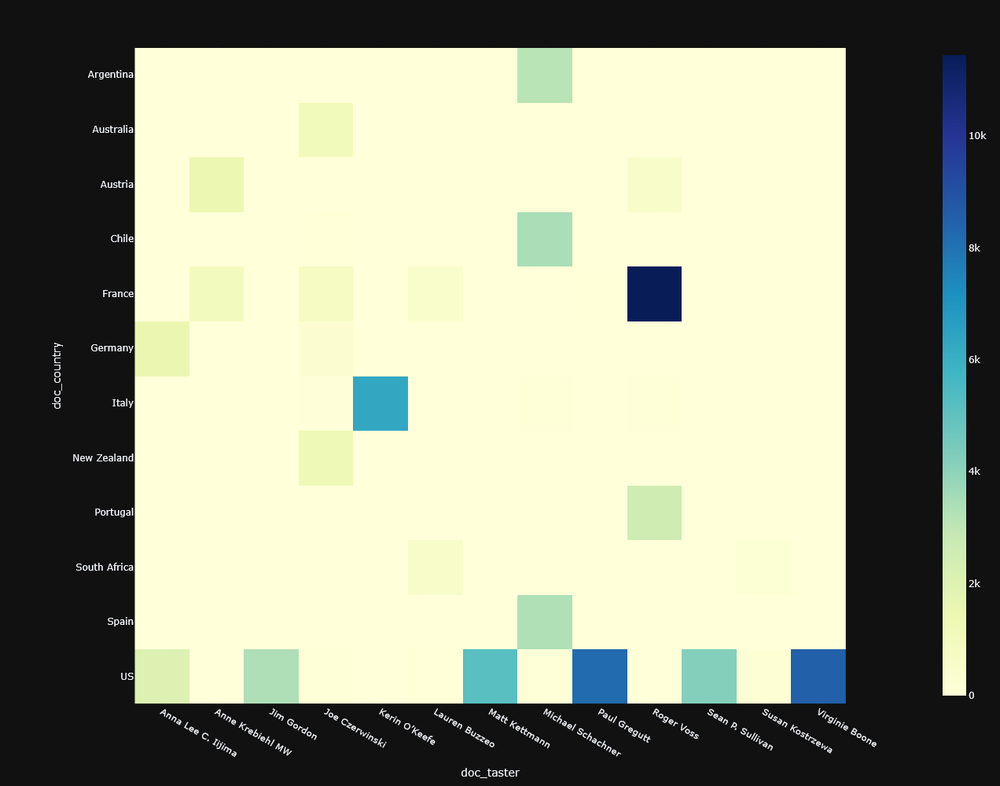

In [44]:
px.imshow(DOC2.value_counts(['doc_country', 'doc_taster']).unstack(fill_value=0), color_continuous_scale=px.colors.colorbrewer.YlGnBu, height=1000)

<!-- <img src="country-taster-heatmap-nocluster.png" style="height:1000px;border:1px solid grey;"/> -->


**The Bad**

The alluvial here, however, is clearly more noisy than the heatmap.

<img src="points-topics-sankey.png" />
<img src="points-topics-heatmap.png" />

**Takeaway**: 

- Use Heatmaps when the data are more evenly distributed (high entropy)
- Use Sankey when the data are more unevenly distributed (low entropy)